<a href="https://colab.research.google.com/github/SebastianArriagada/python-work/blob/main/cGAN/object-segmentation/object_segmentation_Pix2Pix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version
!unzip cityscapes-image-pairs.zip 

In [ ]:
!pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d dansbecker/cityscapes-image-pairs # https://www.kaggle.com/dansbecker/cityscapes-image-pairs
!unzip cityscapes-image-pairs.zip 

In [17]:
# Split origin image and labels 
!mkdir ./data
!mkdir ./data/train
!mkdir ./data/val
!mkdir ./data/train/image
!mkdir ./data/train/label
!mkdir ./data/val/image
!mkdir ./data/val/label
!mkdir ./data/test_output_pred/
!mkdir ./data/test_output_png/
!mkdir ./data/test_output_test/
!mkdir ./checkpoints

mkdir: cannot create directory ‘./data’: File exists
mkdir: cannot create directory ‘./data/train’: File exists
mkdir: cannot create directory ‘./data/val’: File exists
mkdir: cannot create directory ‘./data/train/image’: File exists
mkdir: cannot create directory ‘./data/train/label’: File exists
mkdir: cannot create directory ‘./data/val/image’: File exists
mkdir: cannot create directory ‘./data/val/label’: File exists
mkdir: cannot create directory ‘./checkpoints’: File exists


In [1]:
import os
import cv2

# Split training images
path = '/content/cityscapes_data/train/'
image_path = '/content/data/train/image/'
label_path = '/content/data/train/label/'
images_names = os.listdir(path)

for image_name in images_names:
  totalImage = cv2.imread(path + image_name)
  
  image = totalImage[0:256 , 0:256]
  label = totalImage[0:256, 256:512]

  cv2.imwrite(image_path + image_name, image)
  cv2.imwrite(label_path + image_name, label)

# Split val images
path = '/content/cityscapes_data/val/'
image_path = '/content/data/val/image/'
label_path = '/content/data/val/label/'
images_names = os.listdir(path)

for image_name in images_names:
  totalImage = cv2.imread(path + image_name)
  
  image = totalImage[0:256 , 0:256]
  label = totalImage[0:256, 256:512]

  cv2.imwrite(image_path + image_name, image)
  cv2.imwrite(label_path + image_name, label)





KeyboardInterrupt: ignored

In [2]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os


# Ruta datos de entrada
#INPATH = PATH + '/Input'
# Ruta datos de salida
#OUTPATH = PATH + '/Target'

# Ruta datos de entrada y salida
PATH = '/content/data/'
INPATH= PATH + 'train/image/'
OUTPATH = PATH + 'train/label/'
VAL_INPATH =  PATH + 'val/image/'
VAL_OUTPATH = PATH + 'val/label/'

# Ruta de los checkpoints
CKPATH = '/content/checkpoints'

"""
imgurls= !ls -1 '{INPATH}'
for i in range(len(imgurls)):
  imgurls[i]= imgurls[i].replace("'","")
print( imgurls)

imgurls = os.listdir(INPATH)
print( imgurls)
n = len(imgurls)
train_n = round(n*0)

# Listado randomizado
randurls = np.copy(imgurls)

np.random.seed(23)
np.random.shuffle(randurls)
"""

# Particion train/test
tr_urls = os.listdir(INPATH)
ts_urls = os.listdir(VAL_INPATH)

print ( len(tr_urls), len(ts_urls))


2975 500


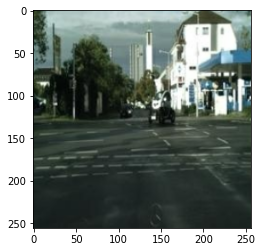

In [3]:
# Rezise imagenes
IMG_WIDTH=256
IMG_HEIGHT=256

def resize(inimg,tgimg,height,width):
    
  inimg=tf.image.resize(inimg,[height,width])
  tgimg=tf.image.resize(tgimg,[height,width])
  return inimg,tgimg

#normaliza el rango[-1, +1]
def normalize(inimg,tgimg):
  inimg=(inimg/127.5)-1
  tgimg=(tgimg/127.5)-1
  return inimg,tgimg

@tf.function()
#aumentacion de datos :random crop+flip
def random_jitter(inimg,tgimg):
  
  inimg,tgimg = resize(inimg,tgimg,286,286)
  
  stacked_image=tf.stack([inimg,tgimg], axis=0)
  cropped_image = tf.image.random_crop(stacked_image, size=[2,IMG_HEIGHT,IMG_WIDTH,3])
  
  inimg,tgimg=cropped_image[0],cropped_image[1]
  
  if tf.random.uniform(()) > 0.5 :
  
    inimg=tf.image.flip_left_right(inimg)
    tgimg=tf.image.flip_left_right(tgimg)

  return inimg,tgimg

def load_image(filename,augment=True, val = False):

  if val :
    inimg=tf.cast(tf.image.decode_jpeg(tf.io.read_file(VAL_INPATH+filename)),tf.float32)[..., :3]
    tgimg=tf.cast(tf.image.decode_jpeg(tf.io.read_file(VAL_OUTPATH+filename)),tf.float32)[..., :3]
  else:
    inimg=tf.cast(tf.image.decode_jpeg(tf.io.read_file(INPATH+filename)),tf.float32)[..., :3]
    tgimg=tf.cast(tf.image.decode_jpeg(tf.io.read_file(OUTPATH+filename)),tf.float32)[..., :3]
  
  inimg,tgimg=resize(inimg,tgimg,IMG_HEIGHT,IMG_WIDTH)

  if augment:
    inimg,tgimg = random_jitter(inimg,tgimg)

  inimg,tgimg= normalize(inimg,tgimg)

  return inimg, tgimg      
  
def load_train_image(filename):
  return load_image(filename,True)
def load_test_image(filename):
  return load_image(filename,False, True)

plt.imshow(((load_train_image(tr_urls[0])[0]) + 1) / 2) 

Train Dataset


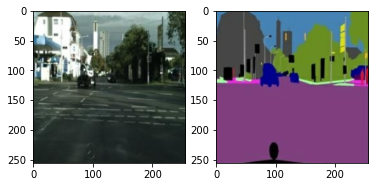

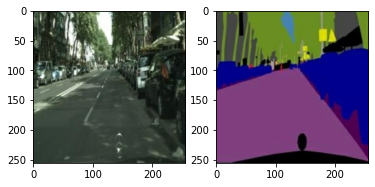

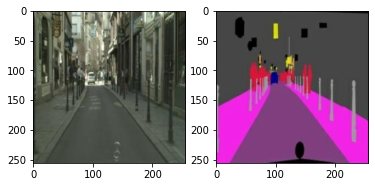

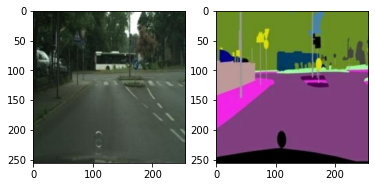

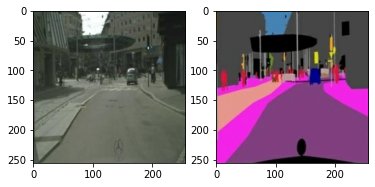

Val Dataset


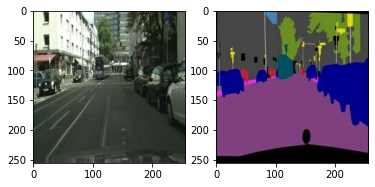

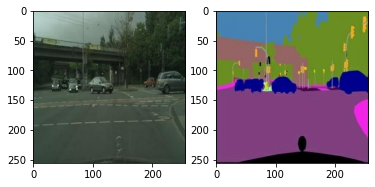

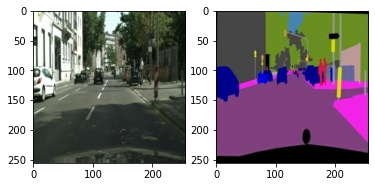

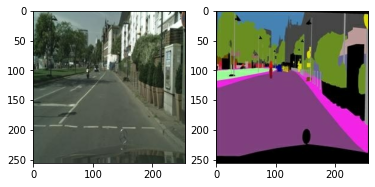

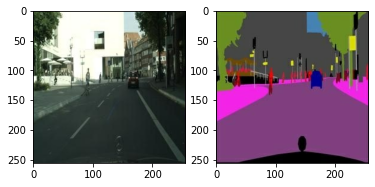

In [14]:
train_dataset=tf.data.Dataset.from_tensor_slices(tr_urls)
train_dataset=train_dataset.map(load_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset=train_dataset.batch(1)

print("Train Dataset")
for inimg,tgimg in  train_dataset.take(5):
  plt.subplot(1,2,1)
  plt.imshow(((inimg[0,...]) + 1) / 2)
  plt.subplot(1,2,2)
  plt.imshow(((tgimg[0,...]) + 1) / 2)
  plt.show()

test_dataset=tf.data.Dataset.from_tensor_slices(ts_urls)
test_dataset=test_dataset.map(load_test_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_dataset=test_dataset.batch(1)

print("Val Dataset")
for inimg,tgimg in  test_dataset.take(5):
  plt.subplot(1,2,1)
  plt.imshow(((inimg[0,...]) + 1) / 2)
  plt.subplot(1,2,2)
  plt.imshow(((tgimg[0,...]) + 1) / 2)
  plt.show()

In [5]:
from tensorflow.keras.layers import *
from tensorflow.keras import *

def downsample(filters,apply_batchnorm=True):

  initializer=tf.random_normal_initializer(0,0.02)

  result=Sequential()

  #capa convolucional
  result.add(Conv2D(filters, 
                    kernel_size=4,
                    strides=2,
                    padding="same",
                    kernel_initializer=initializer,
                    use_bias=not apply_batchnorm))
  
  if apply_batchnorm:
  #capa de batch normalization
      result.add(BatchNormalization())

  #capa de activacion
  result.add(LeakyReLU())
  
  return result
downsample(64)  

In [6]:
def upsample(filters,apply_dropout=False):

  initializer=tf.random_normal_initializer(0,0.02)
  result=Sequential()

  #capa convolucional
  result.add(Conv2DTranspose(filters, 
                              kernel_size=4,
                              strides=2,
                              padding="same",
                              kernel_initializer=initializer,
                              use_bias=False))
  
  #capa de batch normalization
  result.add(BatchNormalization())

  if apply_dropout:
      # Capa de Dropout
      result.add( Dropout(0.5))

  #capa de activacion
  result.add(ReLU())

  return result

upsample(64)  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


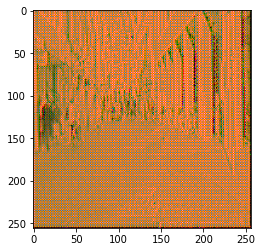

In [7]:
def Generator():
  inputs=tf.keras.layers.Input(shape=[None,None,3])

  down_stack=[
              downsample(64, apply_batchnorm=False),
              downsample(128),
              downsample(256),
              downsample(512),
              downsample(512),
              downsample(512),
              downsample(512),
              downsample(512),
  ]
  up_stack=[
            upsample(512,apply_dropout=True),
            upsample(512,apply_dropout=True),
            upsample(512,apply_dropout=True),
            upsample(512),
            upsample(256),
            upsample(128),
            upsample(64),

  ]
  
  initializer=tf.random_normal_initializer(0,0.02)
  last=Conv2DTranspose(filters=3,
                       kernel_size=4,
                       strides=2,
                       padding="same",
                       kernel_initializer=initializer,
                       activation="tanh")
  x=inputs
  s= []  
  concat=Concatenate()
  
  for down in down_stack:
    x = down(x)
    s.append(x)
  
  s = reversed(s[:-1])  
  
  for up ,sk in zip (up_stack, s):
    x=up(x)
    x=concat([x,sk])

  last=last(x)

  return Model(inputs=inputs,outputs=last )

generator=Generator()
gen_output=generator(((inimg+1)*255), training=False)
plt.imshow(gen_output[0,...])

TensorShape([64, 16, 16, 1])

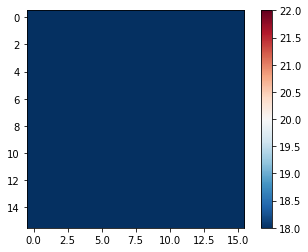

In [8]:
def Discriminator():
  ini=Input(shape=[None,None,3],name="input_img")
  gen=Input(shape=[None,None,3],name="gener_img")
  con=concatenate([ini,gen])
  initializer=tf.random_normal_initializer(0,0.2)
  down1=downsample(64,apply_batchnorm=False)(con)
  down2=downsample(128)(down1)
  down3=downsample(256)(down2)
  down4=downsample(512)(down3)

  last=tf.keras.layers.Conv2D(filters=1,
                              kernel_size=4,
                              strides=1,
                              kernel_initializer=initializer,
                              padding="same")(down4)
                              
  return tf.keras.Model(inputs=[ini,gen],outputs=last)   

discriminator=Discriminator()     

disc_out=discriminator([((inimg+1)*255),gen_output], training=False)
plt.imshow(disc_out[0,...,-1],vmin=20,vmax=20,cmap='RdBu_r')
plt.colorbar()
disc_out.shape   


In [9]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

loss_object=tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(disc_real_output, disc_generated_output):
  #Diferencia entre los true por ser real y el detectado por el discriminador
  real_loss=loss_object(tf.ones_like(disc_real_output),disc_real_output)
  #Diferencia entre los false por ser generado y el detectado por el discriminador
  generated_loss=loss_object(tf.zeros_like(disc_generated_output),disc_generated_output)

  total_disc_loss=real_loss + generated_loss

  return total_disc_loss

In [10]:
LAMBDA=100
def generator_loss(disc_generated_output,gen_output,target):
  gan_loss=loss_object(tf.ones_like(disc_generated_output),disc_generated_output)

  #mean absolute error
  l1_loss=tf.reduce_mean(tf.abs(target - gen_output))
  total_gen_loss= gan_loss + (LAMBDA* l1_loss)
  return total_gen_loss

In [11]:
def generate_images(model,test_input, tar,save_filename = False,display_imgs=True):

  prediction=model(test_input,training=True)

  if save_filename:
    tf.keras.preprocessing.image.save_img(PATH + '/test_output_pred/'+save_filename +'.jpg', prediction[0,...])
    tf.keras.preprocessing.image.save_img(PATH + '/test_output_png/'+save_filename +'.png', prediction[0,...])
    tf.keras.preprocessing.image.save_img(PATH + '/test_output_test/'+save_filename +'.jpg', test_input[0,...])

  plt.figure(figsize=(10,10))

  display_list=[test_input[0],tar[0],prediction[0]]
  title=['Input image','Ground Truth','Predicted Image']
  if display_imgs:
    for i in range(3):
      plt.subplot(1,3,i+1)
      plt.title(title[i])
      plt.imshow(display_list[i]*0.5+0.5)
      plt.axis('off')
  plt.show()

In [12]:
#@tf.function() 
def train_step(input_image,target):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as discr_tape:

    output_image =generator(input_image,training=True)

    output_gen_discr=discriminator([output_image,input_image],training=True)

    output_trg_discr=discriminator([output_image,input_image],training=True)

    discr_loss=discriminator_loss(output_trg_discr,output_gen_discr)

    gen_loss=generator_loss(output_gen_discr,output_image,target)
    

    generator_grads=gen_tape.gradient(gen_loss,generator.trainable_variables)

    discriminator_grads=discr_tape.gradient(discr_loss,discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_grads,generator.trainable_variables))

    discriminator_optimizer.apply_gradients(zip(discriminator_grads,discriminator.trainable_variables))


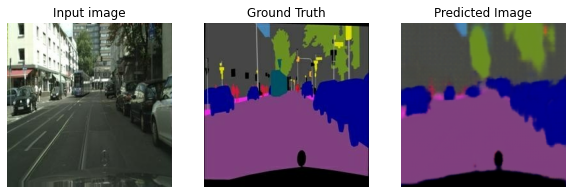

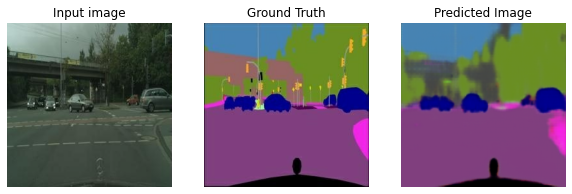

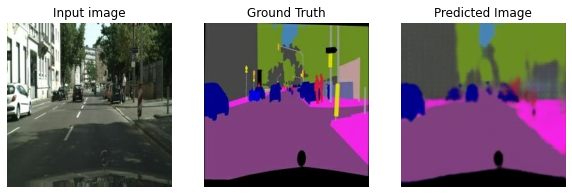

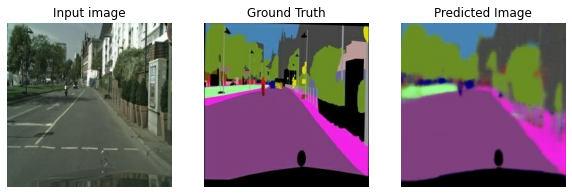

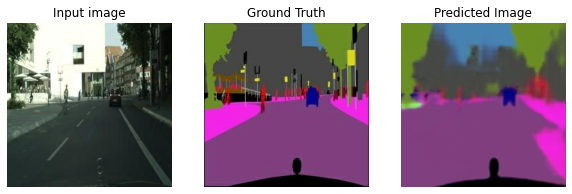

epoch11-train:0/2975
epoch11-train:1/2975
epoch11-train:2/2975
epoch11-train:3/2975
epoch11-train:4/2975
epoch11-train:5/2975
epoch11-train:6/2975
epoch11-train:7/2975
epoch11-train:8/2975
epoch11-train:9/2975
epoch11-train:10/2975
epoch11-train:11/2975
epoch11-train:12/2975
epoch11-train:13/2975
epoch11-train:14/2975
epoch11-train:15/2975
epoch11-train:16/2975
epoch11-train:17/2975
epoch11-train:18/2975
epoch11-train:19/2975
epoch11-train:20/2975
epoch11-train:21/2975
epoch11-train:22/2975
epoch11-train:23/2975
epoch11-train:24/2975
epoch11-train:25/2975
epoch11-train:26/2975
epoch11-train:27/2975
epoch11-train:28/2975
epoch11-train:29/2975
epoch11-train:30/2975
epoch11-train:31/2975
epoch11-train:32/2975
epoch11-train:33/2975
epoch11-train:34/2975
epoch11-train:35/2975
epoch11-train:36/2975
epoch11-train:37/2975
epoch11-train:38/2975
epoch11-train:39/2975


In [ ]:

from  IPython.display import clear_output
import os
checkpoint_prefix=os.path.join(CKPATH,"ckpt")
checkpoint=tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                               discriminator_optimizer=discriminator_optimizer,
                               generator=generator,
                               discriminator=discriminator)
def train(dataset, epochs):
  for epoch in range (epochs):
    imgi=0
    for input_image, target in dataset:
      if imgi % 100 == 0:
        print('epoch'+str(epoch)+'-train:' +str(imgi)+'/'+str(len(tr_urls)))
      imgi+=1
      train_step(input_image,target)
    clear_output(wait=True)
    imgi=0
    for inp,tar in test_dataset.take(5):
      generate_images(generator,inp,tar,str(imgi)+'_'+str(epoch),display_imgs=True)
      imgi+=1
    
    #saving the model every 10 epochs
    if (epoch+1)%10==0:
      checkpoint_prefix=os.path.join(CKPATH,"ckpt")
      checkpoint.save(file_prefix=checkpoint_prefix)


train(train_dataset,40)


In [ ]:
# a label and all meta information
Label = namedtuple( 'Label' , [

    'name'        , # The identifier of this label, e.g. 'car', 'person', ... .
                    # We use them to uniquely name a class

    'id'          , # An integer ID that is associated with this label.
                    # The IDs are used to represent the label in ground truth images
                    # An ID of -1 means that this label does not have an ID and thus
                    # is ignored when creating ground truth images (e.g. license plate).
                    # Do not modify these IDs, since exactly these IDs are expected by the
                    # evaluation server.

    'trainId'     , # Feel free to modify these IDs as suitable for your method. Then create
                    # ground truth images with train IDs, using the tools provided in the
                    # 'preparation' folder. However, make sure to validate or submit results
                    # to our evaluation server using the regular IDs above!
                    # For trainIds, multiple labels might have the same ID. Then, these labels
                    # are mapped to the same class in the ground truth images. For the inverse
                    # mapping, we use the label that is defined first in the list below.
                    # For example, mapping all void-type classes to the same ID in training,
                    # might make sense for some approaches.
                    # Max value is 255!

    'category'    , # The name of the category that this label belongs to

    'categoryId'  , # The ID of this category. Used to create ground truth images
                    # on category level.

    'hasInstances', # Whether this label distinguishes between single instances or not

    'ignoreInEval', # Whether pixels having this class as ground truth label are ignored
                    # during evaluations or not

    'color'       , # The color of this label
    ] )

labels = [
    #       name                     id    trainId   category            catId     hasInstances   ignoreInEval   color
    Label(  'unlabeled'            ,  0 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'ego vehicle'          ,  1 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'rectification border' ,  2 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'out of roi'           ,  3 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'static'               ,  4 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'dynamic'              ,  5 ,      255 , 'void'            , 0       , False        , True         , (111, 74,  0) ),
    Label(  'ground'               ,  6 ,      255 , 'void'            , 0       , False        , True         , ( 81,  0, 81) ),
    Label(  'road'                 ,  7 ,        0 , 'flat'            , 1       , False        , False        , (128, 64,128) ),
    Label(  'sidewalk'             ,  8 ,        1 , 'flat'            , 1       , False        , False        , (244, 35,232) ),
    Label(  'parking'              ,  9 ,      255 , 'flat'            , 1       , False        , True         , (250,170,160) ),
    Label(  'rail track'           , 10 ,      255 , 'flat'            , 1       , False        , True         , (230,150,140) ),
    Label(  'building'             , 11 ,        2 , 'construction'    , 2       , False        , False        , ( 70, 70, 70) ),
    Label(  'wall'                 , 12 ,        3 , 'construction'    , 2       , False        , False        , (102,102,156) ),
    Label(  'fence'                , 13 ,        4 , 'construction'    , 2       , False        , False        , (190,153,153) ),
    Label(  'guard rail'           , 14 ,      255 , 'construction'    , 2       , False        , True         , (180,165,180) ),
    Label(  'bridge'               , 15 ,      255 , 'construction'    , 2       , False        , True         , (150,100,100) ),
    Label(  'tunnel'               , 16 ,      255 , 'construction'    , 2       , False        , True         , (150,120, 90) ),
    Label(  'pole'                 , 17 ,        5 , 'object'          , 3       , False        , False        , (153,153,153) ),
    Label(  'polegroup'            , 18 ,      255 , 'object'          , 3       , False        , True         , (153,153,153) ),
    Label(  'traffic light'        , 19 ,        6 , 'object'          , 3       , False        , False        , (250,170, 30) ),
    Label(  'traffic sign'         , 20 ,        7 , 'object'          , 3       , False        , False        , (220,220,  0) ),
    Label(  'vegetation'           , 21 ,        8 , 'nature'          , 4       , False        , False        , (107,142, 35) ),
    Label(  'terrain'              , 22 ,        9 , 'nature'          , 4       , False        , False        , (152,251,152) ),
    Label(  'sky'                  , 23 ,       10 , 'sky'             , 5       , False        , False        , ( 70,130,180) ),
    Label(  'person'               , 24 ,       11 , 'human'           , 6       , True         , False        , (220, 20, 60) ),
    Label(  'rider'                , 25 ,       12 , 'human'           , 6       , True         , False        , (255,  0,  0) ),
    Label(  'car'                  , 26 ,       13 , 'vehicle'         , 7       , True         , False        , (  0,  0,142) ),
    Label(  'truck'                , 27 ,       14 , 'vehicle'         , 7       , True         , False        , (  0,  0, 70) ),
    Label(  'bus'                  , 28 ,       15 , 'vehicle'         , 7       , True         , False        , (  0, 60,100) ),
    Label(  'caravan'              , 29 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0, 90) ),
    Label(  'trailer'              , 30 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0,110) ),
    Label(  'train'                , 31 ,       16 , 'vehicle'         , 7       , True         , False        , (  0, 80,100) ),
    Label(  'motorcycle'           , 32 ,       17 , 'vehicle'         , 7       , True         , False        , (  0,  0,230) ),
    Label(  'bicycle'              , 33 ,       18 , 'vehicle'         , 7       , True         , False        , (119, 11, 32) ),
    Label(  'license plate'        , -1 ,       -1 , 'vehicle'         , 7       , False        , True         , (  0,  0,142) ),
]

In [ ]:
import os
checkpoint_prefix=os.path.join(CKPATH,"ckpt")
checkpoint=tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                               discriminator_optimizer=discriminator_optimizer,
                               generator=generator,
                               discriminator=discriminator)
checkpoint.save(file_prefix=checkpoint_prefix)

'/content/drive/MyDrive/Pix2Pix/checkpoints/ckpt-1'

In [ ]:
import os

!ls {CKPATH}
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

checkpoint_prefix=os.path.join(CKPATH,"ckpt")
checkpoint=tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                               discriminator_optimizer=discriminator_optimizer,
                               generator=generator,
                               discriminator=discriminator)
#checkpoint.restore(CKPATH + '/ckpt-36')
checkpoint.restore(tf.train.latest_checkpoint(CKPATH))

checkpoint		     ckpt-29.index		  ckpt-36.index
ckpt-1.data-00000-of-00001   ckpt-30.data-00000-of-00001  ckpt-37.index
ckpt-1.index		     ckpt-30.index
ckpt-29.data-00000-of-00001  ckpt-36.data-00000-of-00001


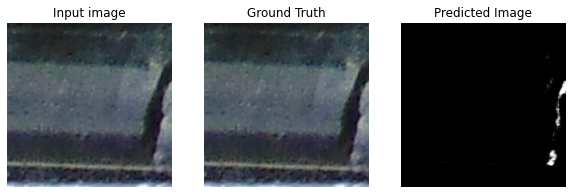

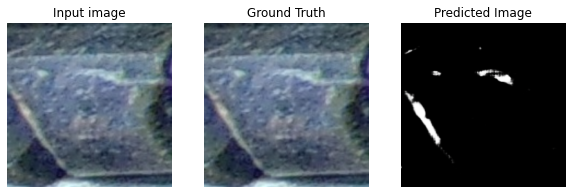

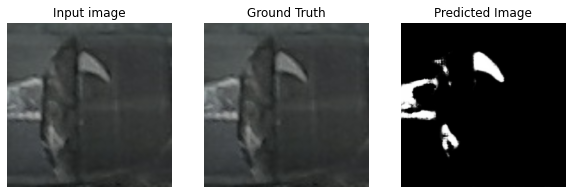

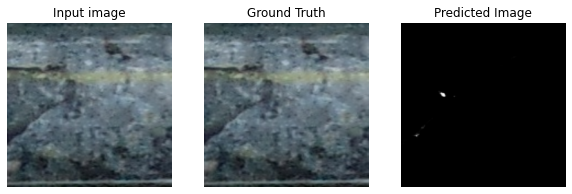

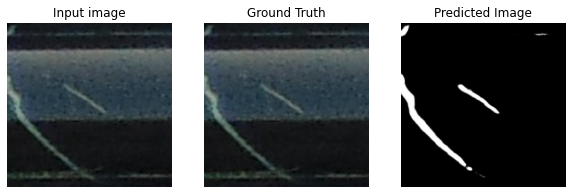

...

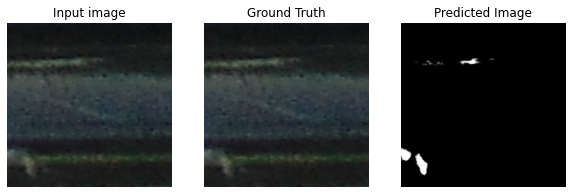

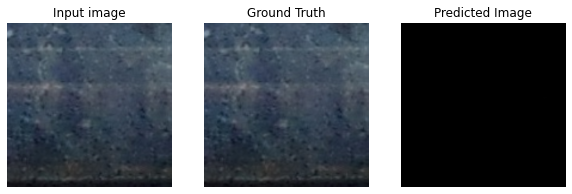

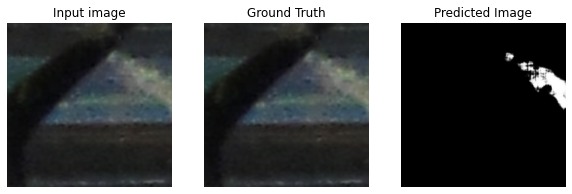

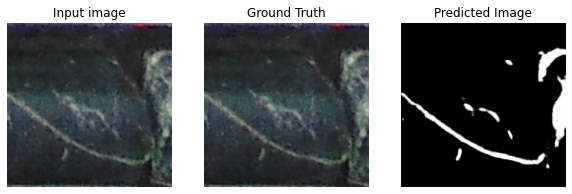

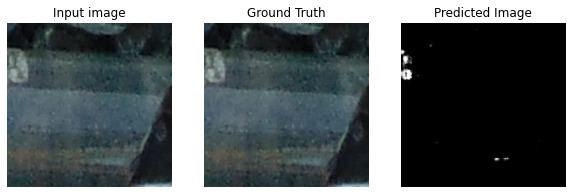

In [ ]:
#guardar imagen con su nombre de origen 
for i in range(len(ts_urls)):
  
  test_dataset=tf.data.Dataset.from_tensor_slices([ts_urls[i],ts_urls[i]])
  test_dataset=test_dataset.map(load_test_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
  test_dataset=test_dataset.batch(1)

  for inp, tar in test_dataset.take(1):
    name=ts_urls[i].replace(".jpg","")
    generate_images(generator, inp, tar, save_filename=str(name))



In [ ]:
# Run the trained model on a few examples from the test dataset
i=1
data={}
for inp, tar in test_dataset.take(len(test_dataset)):
  name=str(inp.numpy())
  name=name.replace("b'","")
  image_name=name.replace("'","")
  
  generate_images(generator, inp, tar, save_filename=str(i))

  data[i]=image_name
  i+=1

In [ ]:
a = !ls {'/content/drive/MyDrive/memoria_actualizada/test_output_png'}
print (len(a))

732


In [ ]:
import cv2
path='/content/drive/MyDrive/memoria_actualizada/test_images/'


for cut in tr_urls:

  train_dataset=tf.data.Dataset.from_tensor_slices(cut)
  train_dataset=train_dataset.map(load_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
  train_dataset=train_dataset.batch(1)
  generate_images(generator, train_dataset, train_dataset, save_filename=str(i))